#### **Harmonization of MRI related metrics across ABCD sites, and between studies.**

Using the recoded ComBAT algorithm by Girard et al. 2025 [1].

[1] Girard, G., Edde, M., Dumais, F., David, Y., Dumont, M., Theaud, G., Houde, J.-C., Boré, A., Descoteaux, M., & Jodoin, P.-M. (2025). Clinical-ComBAT: A diffusion-weighted MRI harmonization method for clinical applications (No. arXiv:2511.04871). arXiv. https://doi.org/10.48550/arXiv.2511.04871


In [1]:
# Imports
import os

import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import font_manager
from matplotlib.patches import ConnectionPatch
import numpy as np
import scipy
import seaborn as sns
from tqdm import tqdm
from p_tqdm import p_map

/Users/anthonygagnon/envs/combat/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [6]:
# Setting up data and output paths.
repository_dir = "~/code/Gagnon_BrainAge_2025/"
data_abcd = "/Volumes/T7/BrainAgeStudy/ABCD/"
output_folder = "/Volumes/T7/BrainAgeStudy/"

# Create output folder if it doesn't exist.
output_dir = f"{output_folder}/Harmonization/"
os.makedirs(output_dir, exist_ok=True)

In [7]:
# Load the atlas description to get the region names.
atlas = pd.read_csv(f"{repository_dir}/atlas/atlas-BrainnetomeChild/atlas-BrainnetomeChild_dseg.tsv", sep="\t")

# Replace BRAIN_STEM, CEREBELLUM_LEFT, and CEREBELLUM_RIGHT in the label column by brainstem, left_cerebellum_cortex, and right_cerebellum_cortex.
atlas["label"] = atlas["label"].replace({"BRAIN_STEM": "brainstem", "CEREBELLUM_LEFT": "left_cerebellum_cortex", "CEREBELLUM_RIGHT": "right_cerebellum_cortex"})

In [8]:
# Fetch Harding font.
font_files = []
for fontpath in font_manager.findSystemFonts(fontpaths=None, fontext='ttf'):
    if "Harding".lower() in fontpath.lower():
        font_files.append(fontpath)
for font_file in font_files:
    font_manager.fontManager.addfont(font_file)

# Set Harding font.
plt.rcParams['font.family'] = 'Harding Text Web'

In [47]:
# Fetch the site distribution for the ABCD dataset.
abcd_data = pd.read_csv(f"{data_abcd}/abcd_y_lt.csv", low_memory=False)
sex_data = pd.read_csv(f"{data_abcd}/abcd_p_demo.csv", low_memory=False)
sex_data = sex_data[sex_data["eventname"] == "baseline_year_1_arm_1"]
hand_data = pd.read_csv(f"{data_abcd}/nc_y_ehis.csv", low_memory=False)
hand_data = hand_data[hand_data["eventname"] == "baseline_year_1_arm_1"]

# Filter site data to keep only rows where eventname == "baseline_year_1_arm_1".
abcd_data = abcd_data[abcd_data["eventname"] == "baseline_year_1_arm_1"]

# Merge site data with sex data.
abcd_data = abcd_data.merge(sex_data[["src_subject_id", "demo_sex_v2"]], on="src_subject_id", how="left")
abcd_data = abcd_data.merge(hand_data[["src_subject_id", "ehi_y_ss_scoreb"]], on="src_subject_id", how="left")

# Swap the src_subject_id column to subjectkey.
abcd_data.rename(columns={"src_subject_id": "subjectkey"}, inplace=True)
abcd_data.rename(columns={"demo_sex_v2": "Sex"}, inplace=True)
abcd_data.rename(columns={"interview_age": "AgeMonths"}, inplace=True)
abcd_data.rename(columns={"site_id_l": "Site"}, inplace=True)
abcd_data.rename(columns={"ehi_y_ss_scoreb": "Handedness"}, inplace=True)

# Invert the handedness score to match other dataset. 1 = left, 2 = right, 3 = ambidextrous.
def invert_handedness(x):
    if x == 1:
        return 2
    elif x == 2:
        return 1
    elif x == 3:
        return 3
    else:
        return np.nan
abcd_data.loc[:, 'Handedness'] = abcd_data.Handedness.apply(invert_handedness)

# Remove the "_" from the subjectkey column and append "sub-" to the beginning.
abcd_data.loc[:, "subjectkey"] = abcd_data.loc[:, "subjectkey"].str.replace("_", "")
abcd_data.loc[:, "subjectkey"] = "sub-" + abcd_data.loc[:, "subjectkey"]

# Using the site16 as the reference site, we will harmonize the other sites to it.
# First, fetch the anatomical data for the ABCD dataset.
subcortical_vol_data = pd.read_csv(f"{output_folder}/QC/ABCD_subcortical_volumes_QCed.csv")
rh_cortical_vol_data = pd.read_csv(f"{output_folder}/QC/ABCD_right_cortical_volume_QCed.csv")
lh_cortical_vol_data = pd.read_csv(f"{output_folder}/QC/ABCD_left_cortical_volume_QCed.csv")

# Load excluded subjects.
with open(f"{output_folder}/QC/ABCD_excluded_subjects.txt", "r") as f:
    excluded_subjects = f.read().splitlines()

# Remove the excluded subjects from the data.
subcortical_vol_data = subcortical_vol_data[~subcortical_vol_data["subjectkey"].isin(excluded_subjects)]
rh_cortical_vol_data = rh_cortical_vol_data[~rh_cortical_vol_data["subjectkey"].isin(excluded_subjects)]
lh_cortical_vol_data = lh_cortical_vol_data[~lh_cortical_vol_data["subjectkey"].isin(excluded_subjects)]

# Assert the number of subjects is the same across datasets.
assert len(subcortical_vol_data) == len(rh_cortical_vol_data), "Number of subjects in subcortical and right cortical volume data do not match."
assert len(subcortical_vol_data) == len(lh_cortical_vol_data), "Number of subjects in subcortical and left cortical volume data do not match."

# Extract common subjects.
common_subjects = set(subcortical_vol_data["subjectkey"]).intersection(set(abcd_data["subjectkey"]))
print(f"Number of common subjects: {len(common_subjects)}")

# Filter the data to only include the common subjects.
subcortical_vol_data = subcortical_vol_data[subcortical_vol_data["subjectkey"].isin(common_subjects)]
subcortical_vol_data.sort_values(by="subjectkey", inplace=True)
rh_cortical_vol_data = rh_cortical_vol_data[rh_cortical_vol_data["subjectkey"].isin(common_subjects)]
rh_cortical_vol_data.sort_values(by="subjectkey", inplace=True)
lh_cortical_vol_data = lh_cortical_vol_data[lh_cortical_vol_data["subjectkey"].isin(common_subjects)]
lh_cortical_vol_data.sort_values(by="subjectkey", inplace=True)
abcd_data = abcd_data[abcd_data["subjectkey"].isin(common_subjects)]
abcd_data.sort_values(by="subjectkey", inplace=True)

# Assert subjectkey columns are identical across datasets.
assert all([a == b for a, b in zip(rh_cortical_vol_data["subjectkey"], lh_cortical_vol_data["subjectkey"])]), "Subject keys do not match between subcortical and right cortical volume data."
assert all([a == b for a, b in zip(subcortical_vol_data["subjectkey"], lh_cortical_vol_data["subjectkey"])]), "Subject keys do not match between subcortical and left cortical volume data."
assert all([a == b for a, b in zip(subcortical_vol_data["subjectkey"], abcd_data["subjectkey"])]), "Subject keys do not match between subcortical volume data and ABCD data."

Number of common subjects: 9076


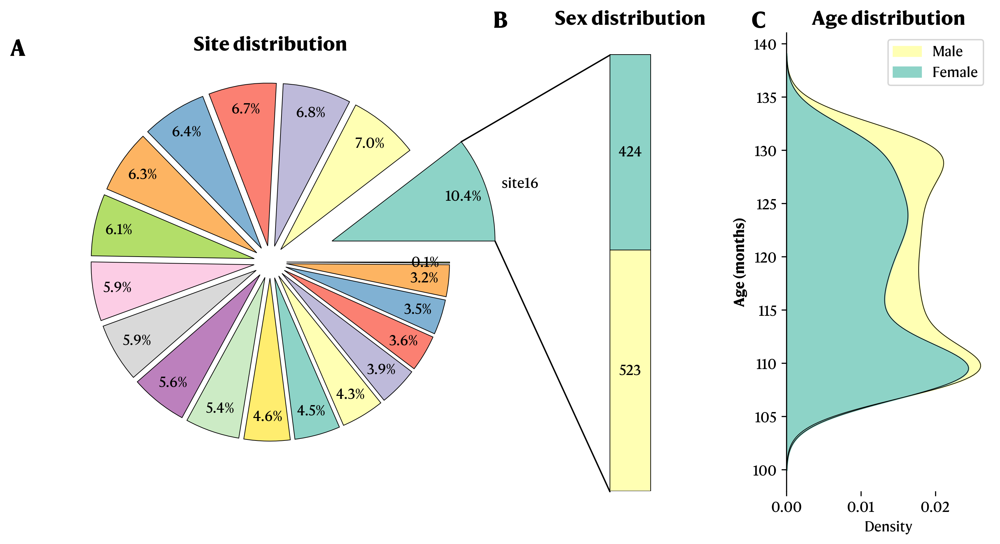

In [80]:
# Create a bar of pie chart for the site distribution, using site16 as the site column.
# First, create the colormap from set3 palette.
cmap = sns.color_palette("Set3", len(abcd_data.Site.unique()))

# Creata a bar of pie chart for the site distribution.
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 6), gridspec_kw=dict(width_ratios=[2, 1, 1],
                                                                            height_ratios=[1]), dpi=300)

# Calculate the ratio of each site.
site_counts = abcd_data["Site"].value_counts()
site_counts = site_counts[site_counts > 0]
site_counts = site_counts / site_counts.sum() * 100

overall_ratios = site_counts.values
overall_labels = ["site16"] + [""] * (len(site_counts.index) - 1)
explode = [0.4] + [0.1] * (len(overall_ratios) - 1)
wedges, *_ = ax1.pie(overall_ratios, autopct='%1.1f%%', explode=explode,
                     colors=cmap, labels=overall_labels,
                     pctdistance=0.85,
                     wedgeprops={"linewidth": 0.5, "edgecolor": "black"},)

# Bar charts params.
sex_count = abcd_data[abcd_data["Site"] == "site16"].Sex.value_counts()
sex_ratio = sex_count.values
sex_labels = ["Male", "Female"]
bottom = 1
width = 0.2

# Set title for pie chart.
ax1.set_title("Site distribution", fontdict={"fontsize": 14, "weight": "bold"})

# colormap for bar and density plots.
set2 = sns.color_palette("Set3")

for j, (height, label) in enumerate(reversed([*zip(sex_ratio, sex_labels)])):
    bottom -= height
    bc = ax2.bar(0, height, width, bottom=bottom, color=set2[j], label=label,
                 alpha=1, edgecolor="black", linewidth=0.5)
    ax2.bar_label(bc, label_type='center')

# Set the title and labels.
ax2.set_title("Sex distribution", fontdict={"fontsize": 14, "weight": "bold"})
ax2.axis("off")
ax2.set_xlim(- 2.5 * width, 2.5 * width)

# use ConnectionPatch to draw lines between the pie and bar charts.
theta1, theta2 = wedges[0].theta1, wedges[0].theta2
center, r = wedges[0].center, wedges[0].r
bar_height = sum(sex_ratio)

# Draw the connection lines.
x = r * np.cos(np.pi / 180 * theta2) + center[0]
y = r * np.sin(np.pi / 180 * theta2) + center[1]
con = ConnectionPatch(xyA=(-width / 2, 0), coordsA=ax2.transData,
                      xyB=(x, y), coordsB=ax1.transData)
con.set_color("black")
con.set_linewidth(1)
ax2.add_artist(con)

# Bottom line.
x = r * np.cos(np.pi / 180 * theta1) + center[0]
y = r * np.sin(np.pi / 180 * theta1) + center[1]
con = ConnectionPatch(xyA=(-width / 2, -bar_height), coordsA=ax2.transData,
                      xyB=(x, y), coordsB=ax1.transData)
con.set_color("black")
con.set_linewidth(1)
ax2.add_artist(con)

# Add age distribution as a density plot, stratified by sex.
sns.kdeplot(data=abcd_data[abcd_data["Site"] == "site16"], y="AgeMonths",
            hue="Sex", hue_order=[2, 1], ax=ax3, fill=True, palette=[set2[0], set2[1]],
            alpha=1, linewidth=1, multiple="layer")
sns.kdeplot(data=abcd_data[abcd_data["Site"] == "site16"], y="AgeMonths",
            hue="Sex", hue_order=[2, 1], ax=ax3, fill=False, palette=["black", "black"],
            alpha=1, linewidth=0.5, multiple="layer", legend=False, zorder=2)
ax3.set_title("Age distribution", fontdict={"fontsize": 14, "weight": "bold"})
ax3.set_ylabel("Age (months)", fontdict={"fontsize": 10, "weight": "bold"})
ax3.spines[["top", "right", "bottom"]].set_visible(False)
ax3.legend(["Male", "Female"], title="")

# Add A, B, C labels to the subplots.
for i, ax in enumerate([ax1, ax2, ax3]):
    ax.text(-0.1, 1.05, f"{chr(65 + i)}", transform=ax.transAxes,
            fontsize=16, fontweight="bold", va="top", ha="right")


plt.savefig(f"{output_dir}/site_distribution.png", bbox_inches="tight", pad_inches=0.1, dpi=300)

In [49]:
# Creating the sMRI matrix, intertwining the subcortical and cortical data.
cols = [item for pair in zip(lh_cortical_vol_data.columns[1:], rh_cortical_vol_data.columns[1:]) for item in pair]
cols.extend(subcortical_vol_data.columns[1:])

# Assert subject IDs are identical in the three sMRI df.
assert all([a == b for a, b in zip(rh_cortical_vol_data["subjectkey"], lh_cortical_vol_data["subjectkey"])]), "Subject IDs are not identical in the right and left cortical volume dataframes."
assert all([a == b for a, b in zip(rh_cortical_vol_data["subjectkey"], subcortical_vol_data["subjectkey"])]), "Subject IDs are not identical in the right cortical volume and subcortical volume dataframes."

# Convert each row of the sMRI data into a column.
abcd_vol_data = pd.DataFrame(columns=subcortical_vol_data["subjectkey"], index=cols)
for row in range(subcortical_vol_data.shape[0]):
    data = [item for pair in zip(lh_cortical_vol_data.iloc[row, 1:], rh_cortical_vol_data.iloc[row, 1:]) for item in pair]
    data.extend(subcortical_vol_data.iloc[row, 1:])
    abcd_vol_data[subcortical_vol_data.iloc[row, 0]] = data

# Assert that the first column is equal to the atlas labels.
assert all([a == b for a, b in zip(abcd_vol_data.index, atlas["label"])]), "Atlas labels are not equal to the first column of the sMRI data."

In [50]:
def create_harmonization_df(smri, demo, metric):
    """
    Create a harmonization dataframe from the ABCD dataset.
    """
    # Create a list of list to store the data.
    records = []

    # Loop over each subject.
    for s, sub in enumerate(tqdm(smri.columns, desc="Formatting data for harmonization")):

        # Get smri data for the subject.
        smri_data = smri.loc[:, sub].values

        # Get the demographic data for the subject.
        site = demo.loc[demo["subjectkey"] == sub, "Site"].values[0]
        age = demo.loc[demo["subjectkey"] == sub, "AgeMonths"].values[0]
        handedness = demo.loc[demo["subjectkey"] == sub, "Handedness"].values[0]
        sex = demo.loc[demo["subjectkey"] ==  sub, "Sex"].values[0]

        for i, region in enumerate(smri.index):
            records.append([sub, region, smri_data[i], metric, site, age, handedness, sex, 'HC'])
        
    return pd.DataFrame(records, columns=['sid', 'bundle', 'mean', 'metric', 'site', 'age', 'handedness', 'sex', 'disease'])

# Create the harmonization dataframe.
abcd_harmonization_vol_df = create_harmonization_df(abcd_vol_data, abcd_data, "volume")

# Drop rows where sex == 3. (only 2 subjects)
abcd_harmonization_vol_df = abcd_harmonization_vol_df[abcd_harmonization_vol_df["sex"] != 3]

Formatting data for harmonization:   0%|          | 0/9076 [00:00<?, ?it/s]

Formatting data for harmonization: 100%|██████████| 9076/9076 [00:18<00:00, 504.12it/s]


In [41]:
# Iterate over sites and save the data as a csv file.
for site in tqdm(abcd_harmonization_vol_df["site"].unique(), desc="Saving harmonization data"):
    site_data = abcd_harmonization_vol_df[abcd_harmonization_vol_df["site"] == site]
    site_data.to_csv(f"{output_folder}/Harmonization/ABCD_harmonization_vol_{site}.csv", index=False)

Saving harmonization data: 100%|██████████| 19/19 [00:06<00:00,  3.06it/s]


In [42]:
# Save the sites in a text file.
with open(f"{output_folder}/Harmonization/ABCD_harmonization_sites.txt", "w") as f:
    for site in abcd_harmonization_vol_df["site"].unique():
        f.write(f"{site}\n")

In [43]:
# Define function to run harmonization using p_map.
def run_harmonize(site):
    """
    Run harmonization using p_map.
    """
    if site == "site16":
        # Skip site16 as it is the reference site.
        return None

    # Run the harmonization.
    !combat_quick.py {output_folder}/Harmonization/ABCD_harmonization_vol_site16.csv {output_folder}/Harmonization/ABCD_harmonization_vol_{site}.csv --bundles brainstem --out_dir {output_folder}/Harmonization/{site}_harm_vol_outputs/ --ignore_handedness -f > /dev/null 2>&1

    return "Success for site: " + site

In [44]:
# ** This is a long running process, go get a coffee! **
# Run the harmonization using p_map.
results = p_map(run_harmonize, abcd_harmonization_vol_df["site"].unique(), num_cpus=6)

100%|██████████| 19/19 [1:50:02<00:00, 347.49s/it] 


In [51]:
# Load the thickness data.
lh_cortical_thickness_data = pd.read_csv(f"{output_folder}/QC/ABCD_left_cortical_thickness_QCed.csv")
rh_cortical_thickness_data = pd.read_csv(f"{output_folder}/QC/ABCD_right_cortical_thickness_QCed.csv")

# Filter for common subjects.
lh_cortical_thickness_data = lh_cortical_thickness_data[lh_cortical_thickness_data["subjectkey"].isin(common_subjects)]
lh_cortical_thickness_data.sort_values(by="subjectkey", inplace=True)
rh_cortical_thickness_data = rh_cortical_thickness_data[rh_cortical_thickness_data["subjectkey"].isin(common_subjects)]
rh_cortical_thickness_data.sort_values(by="subjectkey", inplace=True)

# Assert subjectkey columns are identical across datasets.
assert all([a == b for a, b in zip(rh_cortical_thickness_data["subjectkey"], lh_cortical_thickness_data["subjectkey"])]), "Subject keys do not match between left and right cortical thickness data."
assert all([a == b for a, b in zip(lh_cortical_thickness_data["subjectkey"], abcd_data["subjectkey"])]), "Subject keys do not match between left cortical thickness data and ABCD data."

In [52]:
# Prepare the harmonized data for thickness and area.
# Creating the sMRI matrix, intertwining the cortical data.
cols = [item for pair in zip(lh_cortical_thickness_data.columns[1:], rh_cortical_thickness_data.columns[1:]) for item in pair]

# Assert subject IDs are identical in the three sMRI df.
assert all([a == b for a, b in zip(rh_cortical_vol_data["subjectkey"], lh_cortical_vol_data["subjectkey"])]), "Subject IDs are not identical in the right and left cortical volume dataframes."

# Convert each row of the sMRI data into a column.
abcd_thickness_data = pd.DataFrame(columns=lh_cortical_thickness_data["subjectkey"], index=cols)
for row in range(lh_cortical_thickness_data.shape[0]):
    data = [item for pair in zip(lh_cortical_thickness_data.iloc[row, 1:], rh_cortical_thickness_data.iloc[row, 1:]) for item in pair]
    abcd_thickness_data[lh_cortical_thickness_data.iloc[row, 0]] = data

# Assert that the first column is equal to the atlas labels.
assert all([a == b for a, b in zip(abcd_vol_data.index, atlas["label"][:188])]), "Atlas labels are not equal to the first column of the sMRI data."

In [53]:
abcd_harmonization_thickness_df = create_harmonization_df(abcd_thickness_data, abcd_data, "thickness")

# Drop rows where sex == 3. (only 2 subjects)
abcd_harmonization_thickness_df = abcd_harmonization_thickness_df[abcd_harmonization_thickness_df["sex"] != 3]

Formatting data for harmonization: 100%|██████████| 9076/9076 [00:18<00:00, 500.03it/s]


In [54]:
# Iterate over sites and save the data as a csv file.
for site in tqdm(abcd_harmonization_thickness_df["site"].unique(), desc="Saving harmonization data"):
    site_data = abcd_harmonization_thickness_df[abcd_harmonization_thickness_df["site"] == site]
    site_data.to_csv(f"{output_folder}/Harmonization/ABCD_harmonization_thickness_{site}.csv", index=False)

Saving harmonization data: 100%|██████████| 19/19 [00:05<00:00,  3.46it/s]


In [55]:
# ** This is a long running process, go get a coffee! **
def run_harmonization_thick(site):
    """
    Run harmonization using p_map.
    """
    if site == "site16":
        # Skip site16 as it is the reference site.
        return None

    # Run the harmonization.
    !combat_quick.py {output_folder}/Harmonization/ABCD_harmonization_thickness_site16.csv {output_folder}/Harmonization/ABCD_harmonization_thickness_{site}.csv --bundles IPL_L_6_2  --out_dir {output_folder}/Harmonization/{site}_harm_thickness_outputs/ --ignore_handedness -f > /dev/null 2>&1

    return "Success for site: " + site

results = p_map(run_harmonization_thick, abcd_harmonization_thickness_df["site"].unique(), num_cpus=8)

100%|██████████| 19/19 [1:04:33<00:00, 203.89s/it]


In [56]:
# Load the area data.
lh_cortical_area_data = pd.read_csv(f"{output_folder}/QC/ABCD_left_cortical_area_QCed.csv")
rh_cortical_area_data = pd.read_csv(f"{output_folder}/QC/ABCD_right_cortical_area_QCed.csv")

# Filter for common subjects.
lh_cortical_area_data = lh_cortical_area_data[lh_cortical_area_data["subjectkey"].isin(common_subjects)]
lh_cortical_area_data.sort_values(by="subjectkey", inplace=True)
rh_cortical_area_data = rh_cortical_area_data[rh_cortical_area_data["subjectkey"].isin(common_subjects)]
rh_cortical_area_data.sort_values(by="subjectkey", inplace=True)

# Assert subjectkey columns are identical across datasets.
assert all([a == b for a, b in zip(rh_cortical_area_data["subjectkey"], lh_cortical_area_data["subjectkey"])]), "Subject keys do not match between left and right cortical area data."
assert all([a == b for a, b in zip(lh_cortical_area_data["subjectkey"], abcd_data["subjectkey"])]), "Subject keys do not match between left cortical area data and ABCD data."

In [57]:
# Prepare the harmonized data for area and area.
# Creating the sMRI matrix, intertwining the cortical data.
cols = [item for pair in zip(lh_cortical_area_data.columns[1:], rh_cortical_area_data.columns[1:]) for item in pair]

# Assert subject IDs are identical in the three sMRI df.
assert all([a == b for a, b in zip(rh_cortical_vol_data["subjectkey"], lh_cortical_vol_data["subjectkey"])]), "Subject IDs are not identical in the right and left cortical volume dataframes."

# Convert each row of the sMRI data into a column.
abcd_area_data = pd.DataFrame(columns=lh_cortical_area_data["subjectkey"], index=cols)
for row in range(lh_cortical_area_data.shape[0]):
    data = [item for pair in zip(lh_cortical_area_data.iloc[row, 1:], rh_cortical_area_data.iloc[row, 1:]) for item in pair]
    abcd_area_data[lh_cortical_area_data.iloc[row, 0]] = data

# Assert that the first column is equal to the atlas labels.
assert all([a == b for a, b in zip(abcd_vol_data.index, atlas["label"][:188])]), "Atlas labels are not equal to the first column of the sMRI data."

In [58]:
abcd_harmonization_area_df = create_harmonization_df(abcd_area_data, abcd_data, "area")

# Drop rows with sex == 3. (only 2 subjects)
abcd_harmonization_area_df = abcd_harmonization_area_df[abcd_harmonization_area_df["sex"] != 3]

Formatting data for harmonization: 100%|██████████| 9076/9076 [00:17<00:00, 507.44it/s]


In [59]:
# Iterate over sites and save the data as a csv file.
for site in tqdm(abcd_harmonization_area_df["site"].unique(), desc="Saving harmonization data"):
    site_data = abcd_harmonization_area_df[abcd_harmonization_area_df["site"] == site]
    site_data.to_csv(f"{output_folder}/Harmonization/ABCD_harmonization_area_{site}.csv", index=False)

Saving harmonization data: 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]


In [60]:
# ** This is a long running process, go get a coffee! **
def run_harmonization_area(site):
    """
    Run harmonization using p_map.
    """
    if site == "site16":
        # Skip site16 as it is the reference site.
        return None

    # Run the harmonization.
    !combat_quick.py {output_folder}/Harmonization/ABCD_harmonization_area_site16.csv {output_folder}/Harmonization/ABCD_harmonization_area_{site}.csv --bundles IPL_L_6_2  --out_dir {output_folder}/Harmonization/{site}_harm_area_outputs/ --ignore_handedness -f > /dev/null 2>&1

    return "Success for site: " + site

# Run the harmonization using p_map.
results = p_map(run_harmonization_area, abcd_harmonization_area_df["site"].unique(), num_cpus=8)

100%|██████████| 19/19 [1:03:38<00:00, 200.98s/it]


In [81]:
# Load back up the harmonized data, and stack them vertically.
abcd_harmonized_vol_df = pd.DataFrame()
for site in tqdm(abcd_harmonization_vol_df["site"].unique(), desc="Loading harmonized data"):
    if site == "site16":
        site_harm = pd.read_csv(f"{output_folder}/Harmonization/ABCD_harmonization_vol_site16.csv")
    else:
        # Load the harmonized data.
        site_harm = pd.read_csv(f"{output_folder}/Harmonization/{site}_harm_vol_outputs/{site}.volume.csv.gz", compression="gzip")
    
    # Append the data to the harmonized dataframe.
    abcd_harmonized_vol_df = pd.concat([abcd_harmonized_vol_df, site_harm], axis=0)

# Save the harmonized data.
abcd_harmonized_vol_df.to_csv(f"{output_folder}/Harmonization/ABCD_harmonized_vol.csv", index=False)

Loading harmonized data:   0%|          | 0/19 [00:00<?, ?it/s]

Loading harmonized data: 100%|██████████| 19/19 [00:03<00:00,  5.07it/s]


In [82]:
# Site to list.
site_list = abcd_harmonization_vol_df.site.unique().tolist()
site_list.remove("site16")
site_list.sort()

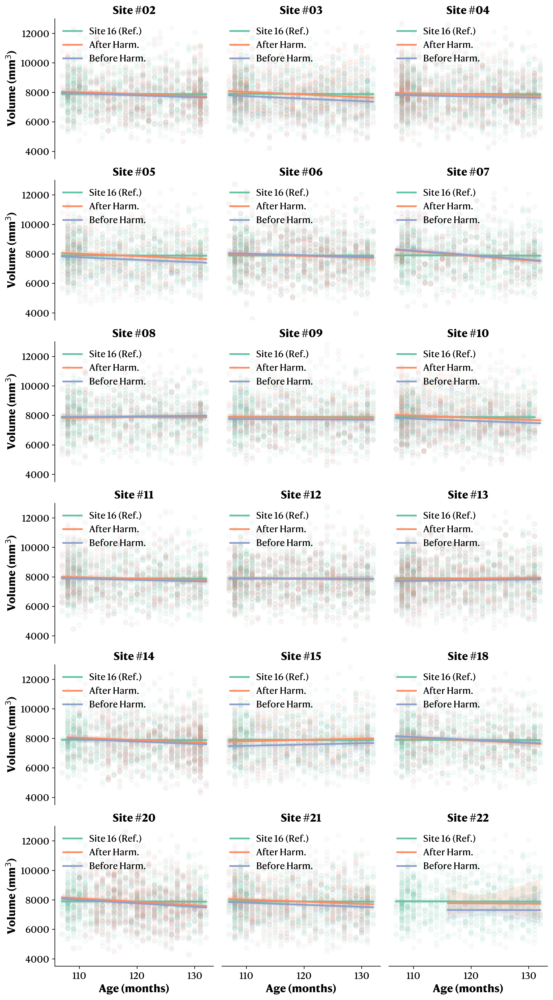

In [ ]:
# Plot the harmonized data in subplots against the site16 data (x=age, y=smri).
fig, axes = plt.subplots(6, 3, figsize=(10, 18), dpi=300)

cmap = sns.color_palette("Set2", 8)

for i, site in enumerate(site_list):
    # Get the data for the site.
    site_data = abcd_harmonized_vol_df[abcd_harmonized_vol_df["site"] == site]

    # Get data before the harmonization.
    site_data_prior = abcd_harmonization_vol_df[abcd_harmonization_vol_df["site"] == site]

    # Get the data for the site16.
    site16_data = abcd_harmonized_vol_df[abcd_harmonized_vol_df["site"] == "site16"]

    # We will use regions IPL_L_6_2 for the plots.
    region = "IPL_L_6_2"
    region_data = site_data[site_data["bundle"] == region]
    region16_data = site16_data[site16_data["bundle"] == region]
    region_data_prior = site_data_prior[site_data_prior["bundle"] == region]

    # Plot the data.
    # Extract the current axis.
    ax = axes.flatten()[i]
    sns.regplot(data=region16_data, x="age", y="mean", ax=ax,
                color=cmap[0], scatter=True, ci=95,
                line_kws={"label": "Site 16 (Ref.)"},
                scatter_kws={"zorder": 0, "alpha": 0.05})
    sns.regplot(data=region_data, x="age", y="mean", ax=ax,
                color=cmap[1], scatter=True, ci=95,
                line_kws={"label": "After Harm."},
                scatter_kws={"zorder": 2, "alpha": 0.05})
    sns.regplot(data=region_data_prior, x="age", y="mean", ax=ax,
                color=cmap[2], scatter=True, ci=95,
                line_kws={"label": "Before Harm."},
                scatter_kws={"zorder": 1, "alpha": 0.05})
    
    # Set legend.
    ax.legend(loc="upper left", fontsize=12, frameon=False)

    site_lab = site.replace("site", "Site #")
    ax.set_title(f"{site_lab}", fontdict={"fontsize": 14, "weight": "bold"})
    #ax.set_xlim(105, 135)
    ax.set_ylim(3500, 13000)

    if i // 3 == 5:
        ax.set_xlabel("Age (months)", fontdict={"fontsize": 14, "weight": "bold"})
        ax.spines[["top", "right"]].set_visible(False)
    else:
        axes[i // 3, i % 3].set_xticklabels([])
        axes[i // 3, i % 3].set_xticks([])
        axes[i // 3, i % 3].set_xlabel("")
        axes[i // 3, i % 3].spines[["top", "right", "bottom"]].set_visible(False)

    if i % 3 == 0:
        ax.set_ylabel("Volume (mm$^3$)", fontdict={"fontsize": 14, "weight": "bold"})
    else:
        axes[i // 3, i % 3].set_yticklabels([])
        axes[i // 3, i % 3].set_yticks([])
        axes[i // 3, i % 3].set_ylabel("")
        axes[i // 3, i % 3].spines[["top", "right", "left"]].set_visible(False)

# Make only left and bottom axes show ticks.
for ax in axes.flatten():
    ax.xaxis.set_ticks_position("bottom")
    ax.yaxis.set_ticks_position("left")
    ax.tick_params(axis="both", labelsize=12)

plt.tight_layout()
plt.savefig(f"{output_folder}/Harmonization/ABCD_harmonization_vol.png", dpi=300)

In [64]:
# Function to reformat back the harmonized data into a features per column and subjects per row.
def reformat_harmonized_data(harmonized_df, nb_regions=227):
    """
    Reformat the harmonized data into a features per column and subjects per row.
    """
    # Fetch bundle list.
    bundles = harmonized_df["bundle"].unique()

    # Create a list of list to store the data.
    records = []

    # Loop over each subject.
    for s, sub in enumerate(tqdm(harmonized_df["sid"].unique(), desc="Reformatting harmonized data")):
        # Get the data for the subject.
        sub_data = harmonized_df[harmonized_df["sid"] == sub]
        assert len(sub_data) == nb_regions, f"Subject {sub} has {len(sub_data)} regions, expected {nb_regions}."

        # Get the demographic data for the subject.
        site = sub_data["site"].values[0]
        age = sub_data["age"].values[0]
        sex = sub_data["sex"].values[0]
        handedness = sub_data["handedness"].values[0]

        data = []
        for bundle in bundles:
            # Get the data for the bundle.
            data.append(sub_data[sub_data["bundle"] == bundle]["mean"].values[0])
        
        # Append the data to the records.
        records.append([sub, site, age, sex, handedness] + data)
    
    # Create a dataframe from the records.
    columns = ["sid", "site", "age", "sex", "handedness"] + bundles.tolist()
    reformatted_df = pd.DataFrame(records, columns=columns)
    reformatted_df.set_index("sid", inplace=True)

    return reformatted_df



In [65]:
reformatted_df = reformat_harmonized_data(abcd_harmonized_vol_df)

Reformatting harmonized data: 100%|██████████| 9074/9074 [15:20<00:00,  9.85it/s]


In [66]:
# Do some random sanity checks to make sure the reformatting was done correctly.
radn_subs = np.random.choice(reformatted_df.index.unique(), 50)
radn_conns = np.random.choice(reformatted_df.columns[3:].unique(), 5)

for s in tqdm(radn_subs, desc="Performing sanity checks on random subjects"):
    for c in radn_conns:

        sub_data = abcd_harmonized_vol_df[abcd_harmonized_vol_df["sid"] == s]
        # Get the data for the subject.
        sub_data = sub_data[sub_data["bundle"] == c]["mean"].values
        # Assert the data for each subject and connection is identical to the original data.
        assert reformatted_df.loc[s, c] == sub_data, f"Data for subject {s} and connection {c} do not match. ({reformatted_df.loc[s, c]} != {sub_data})"

Performing sanity checks on random subjects: 100%|██████████| 50/50 [00:18<00:00,  2.71it/s]


In [67]:
# Saving the reformatted data.
reformatted_df.to_csv(f"{output_folder}/Harmonization/ABCD_harmonized_vol_reformatted.csv", index=True)

In [93]:
# Load back up the harmonized data, and stack them vertically (for thickness).
abcd_harmonized_thickness_df = pd.DataFrame()
for site in tqdm(abcd_harmonization_thickness_df["site"].unique(), desc="Loading harmonized data"):
    if site == "site16":
        site_harm = pd.read_csv(f"{output_folder}/Harmonization/ABCD_harmonization_thickness_site16.csv")
    else:
        # Load the harmonized data.
        site_harm = pd.read_csv(f"{output_folder}/Harmonization/{site}_harm_thickness_outputs/{site}.thickness.csv.gz", compression="gzip")
    
    # Append the data to the harmonized dataframe.
    abcd_harmonized_thickness_df = pd.concat([abcd_harmonized_thickness_df, site_harm], axis=0)

# Save the harmonized data.
abcd_harmonized_thickness_df.to_csv(f"{output_folder}/Harmonization/ABCD_harmonized_thickness.csv", index=False)

Loading harmonized data: 100%|██████████| 19/19 [00:03<00:00,  5.35it/s]


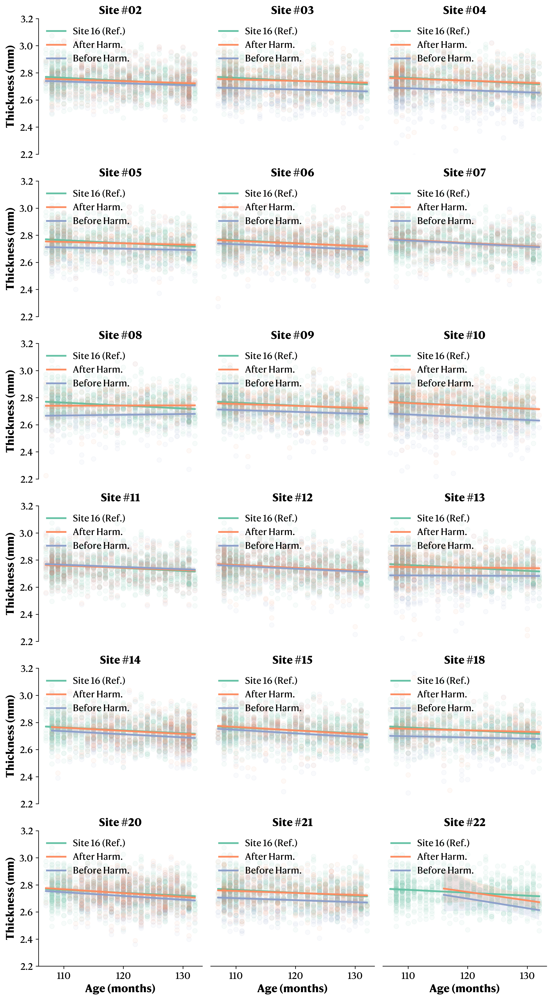

In [ ]:
# Plot the harmonized data in subplots against the site16 data (x=age, y=smri).
fig, axes = plt.subplots(6, 3, figsize=(10, 18), dpi=300)

cmap = sns.color_palette("Set2", 8)

for i, site in enumerate(site_list):
    # Get the data for the site. (after harmonization)
    site_data = abcd_harmonized_thickness_df[abcd_harmonized_thickness_df["site"] == site]
    # Data prior to harmonization.
    site_data_prior = abcd_harmonization_thickness_df[abcd_harmonization_thickness_df["site"] == site]

    # Get the data for the site16.
    site16_data = abcd_harmonized_thickness_df[abcd_harmonized_thickness_df["site"] == "site16"]

    # We will use regions IPL_L_6_2 for the plots.
    region = "IPL_L_6_2"
    region_data = site_data[site_data["bundle"] == region]
    region16_data = site16_data[site16_data["bundle"] == region]
    region_data_prior = site_data_prior[site_data_prior["bundle"] == region]

    # Plot the data.
    # Extract the current axis.
    ax = axes.flatten()[i]
    sns.regplot(data=region16_data, x="age", y="mean", ax=ax,
                color=cmap[0], scatter=True, ci=95,
                line_kws={"label":"Site 16 (Ref.)"},
                scatter_kws={"zorder":0, "alpha":0.05})
    sns.regplot(data=region_data, x="age", y="mean", ax=ax,
                color=cmap[1], scatter=True, ci=95,
                line_kws={"label":"After Harm."},
                scatter_kws={"zorder":2, "alpha":0.05})
    sns.regplot(data=region_data_prior, x="age", y="mean", ax=ax,
                color=cmap[2], scatter=True, ci=95, 
                line_kws={"label":"Before Harm."},
                scatter_kws={"zorder":1, "alpha":0.05})
    ax.legend(loc="upper left", fontsize=12, frameon=False)
    
    # Format site name into Site #XX.
    site_lab = site.replace("site", "Site #")
    ax.set_title(f"{site_lab}", fontdict={"fontsize": 14, "weight": "bold"})
    #ax.set_xlim(105, 135)
    ax.set_ylim(2.2, 3.2)

    if i // 3 == 5:
        ax.set_xlabel("Age (months)", fontdict={"fontsize": 14, "weight": "bold"})
        ax.spines[["top", "right"]].set_visible(False)
    else:
        axes[i // 3, i % 3].set_xticklabels([])
        axes[i // 3, i % 3].set_xticks([])
        axes[i // 3, i % 3].set_xlabel("")
        axes[i // 3, i % 3].spines[["top", "right", "bottom"]].set_visible(False)

    if i % 3 == 0:
        ax.set_ylabel("Thickness (mm)", fontdict={"fontsize": 14, "weight": "bold"})
    else:
        axes[i // 3, i % 3].set_yticklabels([])
        axes[i // 3, i % 3].set_yticks([])
        axes[i // 3, i % 3].set_ylabel("")
        axes[i // 3, i % 3].spines[["top", "right", "left"]].set_visible(False)
# Make only left and bottom axes show ticks.
for ax in axes.flatten():
    ax.xaxis.set_ticks_position("bottom")
    ax.yaxis.set_ticks_position("left")
    ax.tick_params(axis="both", labelsize=12)
plt.tight_layout()
plt.savefig(f"{output_folder}/Harmonization/ABCD_harmonization_thickness.png", dpi=300)

In [70]:
reformatted_thickness_df = reformat_harmonized_data(abcd_harmonized_thickness_df, 188)

Reformatting harmonized data: 100%|██████████| 9074/9074 [12:40<00:00, 11.94it/s]


In [71]:
# Sanity checks.
radn_subs = np.random.choice(reformatted_thickness_df.index.unique(), 50)
radn_conns = np.random.choice(reformatted_thickness_df.columns[3:].unique(), 5)

for s in tqdm(radn_subs, desc="Performing sanity checks on random subjects"):
    for c in radn_conns:

        sub_data = abcd_harmonized_thickness_df[abcd_harmonized_thickness_df["sid"] == s]
        # Get the data for the subject.
        sub_data = sub_data[sub_data["bundle"] == c]["mean"].values
        # Assert the data for each subject and connection is identical to the original data.
        assert reformatted_thickness_df.loc[s, c] == sub_data, f"Data for subject {s} and connection {c} do not match."

Performing sanity checks on random subjects: 100%|██████████| 50/50 [00:15<00:00,  3.25it/s]


In [72]:
# Export the reformatted data.
reformatted_thickness_df.to_csv(f"{output_folder}/Harmonization/ABCD_harmonized_thickness_reformatted.csv", index=True)

In [96]:
# Loading back up the harmonized data, and stack them vertically (for area).
abcd_harmonized_area_df = pd.DataFrame()

for site in tqdm(abcd_harmonization_area_df["site"].unique(), desc="Loading harmonized data"):
    if site == "site16":
        site_harm = pd.read_csv(f"{output_folder}/Harmonization/ABCD_harmonization_area_site16.csv")
    else:
        # Load the harmonized data.
        site_harm = pd.read_csv(f"{output_folder}/Harmonization/{site}_harm_area_outputs/{site}.area.csv.gz", compression="gzip")
    
    # Append the data to the harmonized dataframe.
    abcd_harmonized_area_df = pd.concat([abcd_harmonized_area_df, site_harm], axis=0)

# Save the harmonized data.
abcd_harmonized_area_df.to_csv(f"{output_folder}/Harmonization/ABCD_harmonized_area.csv", index=False)

Loading harmonized data: 100%|██████████| 19/19 [00:03<00:00,  5.98it/s]


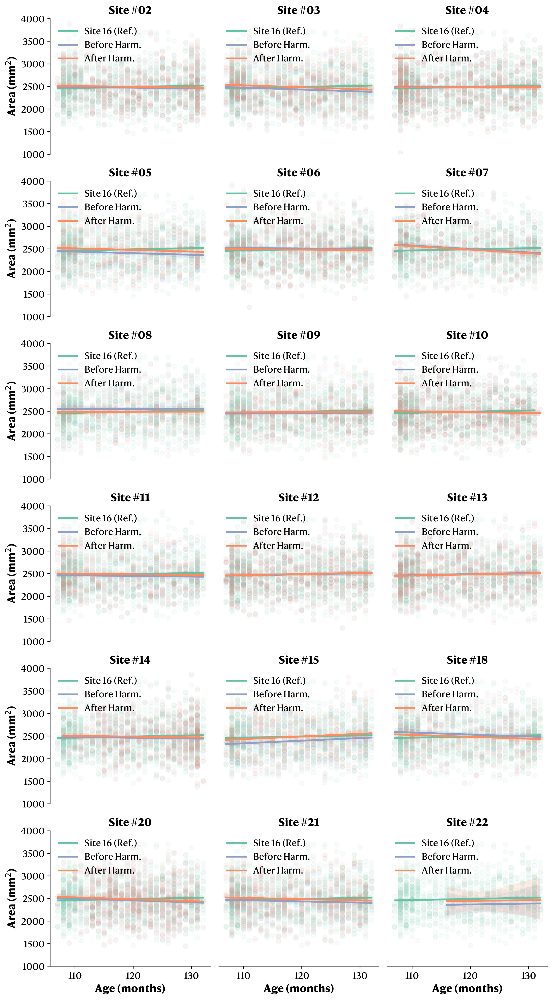

In [98]:
# Plot the harmonized data in subplots against the site16 data (x=age, y=smri).
fig, axes = plt.subplots(6, 3, figsize=(10, 18), dpi=300)

cmap = sns.color_palette("Set2", 8)

for i, site in enumerate(site_list):
    # Get the data for the site.
    site_data = abcd_harmonized_area_df[abcd_harmonized_area_df["site"] == site]

    # Get data before the harmonization.
    site_data_prior = abcd_harmonization_area_df[abcd_harmonization_area_df["site"] == site]

    # Get the data for the site16.
    site16_data = abcd_harmonized_area_df[abcd_harmonized_area_df["site"] == "site16"]

    # We will use regions IPL_L_6_5 for the plots.
    region = "IPL_L_6_2"
    region_data = site_data[site_data["bundle"] == region]
    region16_data = site16_data[site16_data["bundle"] == region]
    region_data_prior = site_data_prior[site_data_prior["bundle"] == region]

    # Plot the data.
    # Extract the current axis.
    ax = axes.flatten()[i]
    sns.regplot(data=region16_data, x="age", y="mean", ax=ax,
                color=cmap[0], scatter=True, ci=95,
                line_kws={"label":"Site 16 (Ref.)"},
                scatter_kws={"zorder":0, "alpha":0.05})
    sns.regplot(data=region_data_prior, x="age", y="mean", ax=ax,
                color=cmap[2], scatter=True, ci=95,
                line_kws={"label":"Before Harm."},
                scatter_kws={"zorder":1, "alpha":0.05})
    sns.regplot(data=region_data, x="age", y="mean", ax=ax,
                color=cmap[1], scatter=True, ci=95,
                line_kws={"label":"After Harm."},
                scatter_kws={"zorder":2, "alpha":0.05})

    ax.legend(loc="upper left", fontsize=12, frameon=False)

    site_lab = site.replace("site", "Site #")
    ax.set_title(f"{site_lab}", fontdict={"fontsize": 14, "weight": "bold"})
    #ax.set_xlim(105, 135)
    ax.set_ylim(1000, 4000)

    if i // 3 == 5:
        ax.set_xlabel("Age (months)", fontdict={"fontsize": 14, "weight": "bold"})
        ax.spines[["top", "right"]].set_visible(False)
    else:
        axes[i // 3, i % 3].set_xticklabels([])
        axes[i // 3, i % 3].set_xticks([])
        axes[i // 3, i % 3].set_xlabel("")
        axes[i // 3, i % 3].spines[["top", "right", "bottom"]].set_visible(False)
    
    if i % 3 == 0:
        ax.set_ylabel("Area (mm$^2$)", fontdict={"fontsize": 14, "weight": "bold"})
    else:
        axes[i // 3, i % 3].set_yticklabels([])
        axes[i // 3, i % 3].set_yticks([])
        axes[i // 3, i % 3].set_ylabel("")
        axes[i // 3, i % 3].spines[["top", "right", "left"]].set_visible(False)

# Make only left and bottom axes show ticks.
for ax in axes.flatten():
    ax.xaxis.set_ticks_position("bottom")
    ax.yaxis.set_ticks_position("left")
    ax.tick_params(axis="both", labelsize=12)
plt.tight_layout()
plt.savefig(f"{output_folder}/Harmonization/ABCD_harmonization_area.png", dpi=300)

In [75]:
reformatted_area_df = reformat_harmonized_data(abcd_harmonized_area_df, 188)

Reformatting harmonized data: 100%|██████████| 9074/9074 [12:42<00:00, 11.90it/s]


In [76]:
# Sanity checks.
radn_subs = np.random.choice(reformatted_area_df.index.unique(), 50)
radn_conns = np.random.choice(reformatted_area_df.columns[3:].unique(), 5)

for s in tqdm(radn_subs, desc="Performing sanity checks on random subjects"):
    for c in radn_conns:

        sub_data = abcd_harmonized_area_df[abcd_harmonized_area_df["sid"] == s]
        # Get the data for the subject.
        sub_data = sub_data[sub_data["bundle"] == c]["mean"].values
        # Assert the data for each subject and connection is identical to the original data.
        assert reformatted_area_df.loc[s, c] == sub_data, f"Data for subject {s} and connection {c} do not match."

Performing sanity checks on random subjects: 100%|██████████| 50/50 [00:15<00:00,  3.25it/s]


In [77]:
# Export the reformatted data.
reformatted_area_df.to_csv(f"{output_folder}/Harmonization/ABCD_harmonized_area_reformatted.csv", index=True)